In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

**Convention on imports**
* It is convention to put builtin imports first
* Then standard third party imports
* Then custom imports (pyrankability)

In [2]:
import copy
import os

In [3]:
import pandas as pd
import numpy as np

In [4]:
import sys
from pathlib import Path
home = str(Path.home())

sys.path.insert(0,"%s/rankability_toolbox_dev"%home)

In [5]:
import pyrankability

In [6]:
from base import *

In [60]:
def read_data(teams_file,games_file):
    teams_2014 = pd.read_csv(teams_file,header=None)
    teams_2014.columns=["number","name"]
    games_2014 = pd.read_csv(games_file,header=None)
    games_2014.columns = ["notsure1","date","team1","H_A_N1","points1","team2","H_A_N2","points2"]
    team1_names = teams_2014.copy()
    team1_names.columns = ["team1","team1_name"]
    team1_names.set_index('team1',inplace=True)
    games_2014 = games_2014.set_index("team1").join(team1_names,how='inner').reset_index()
    team2_names = teams_2014.copy()
    team2_names.columns = ["team2","team2_name"]
    team2_names.set_index('team2',inplace=True)
    games_2014 = games_2014.set_index("team2").join(team2_names,how='inner').reset_index()
    games_2014["date"] = pd.to_datetime(games_2014["date"],format="%Y%m%d")
    games_2014["team1_name"] = games_2014["team1_name"].str.replace(" ","")
    games_2014["team2_name"] = games_2014["team2_name"].str.replace(" ","")
    games = games_2014.sort_values(by='date')
    return games

In [61]:
games={}
years = [2021]
for year in years:
    games[year] = read_data('data/%steams.txt'%year,'data/%sgames.txt'%year)
games[year]

,team2,team1,notsure1,date,H_A_N1,points1,H_A_N2,points2,team1_name,team2_name
828,86,151,738119,2020-11-25,1,79,-1,44,Louisville,Evansville
808,85,1,738119,2020-11-25,0,70,0,47,Abilene_Chr,ETSU
962,98,192,738119,2020-11-25,1,78,-1,71,Navy,G_Washington
2515,248,9,738119,2020-11-25,-1,81,1,61,Appalachian_St,S_Carolina_St
2266,224,176,738119,2020-11-25,1,91,-1,64,Missouri,Oral_Roberts
...,...,...,...,...,...,...,...,...,...,...
3489,339,185,738220,2021-03-06,-1,66,1,60,Mt_St_Mary's,Wagner
1799,183,70,738220,2021-03-06,1,82,-1,75,Delaware_St,Morgan_St
220,22,182,738220,2021-03-06,0,86,0,71,Morehead_St,Belmont
3274,318,348,738220,2021-03-06,0,73,0,60,William_&_Mary,UNC_Wilmington


In [62]:
year = 2021

In [63]:
game_df = pd.DataFrame({"team1_name":games[year]['team1_name'],
                            "team1_score":games[year]['points1'],
                            "team1_H_A_N": games[year]['H_A_N1'],
                            "team2_name":games[year]['team2_name'],
                            "team2_score":games[year]['points2'],
                            "team2_H_A_N": games[year]['H_A_N1'],
                            "date": games[year]['date']
                           }).sort_values(by='date').drop('date',axis=1)

map_func = lambda linked: pyrankability.construct.massey_matrices(linked,direct_thres=0,spread_thres=0)
massey_matrix,massey_b,indirect_massey_matrix,indirect_massey_b = pyrankability.construct.map_vectorized(game_df,map_func)

map_func = lambda linked: pyrankability.construct.colley_matrices(linked,direct_thres=0,spread_thres=0)
colley_matrix,colley_b,indirect_colley_matrix,indirect_colley_b = pyrankability.construct.map_vectorized(game_df,map_func)

In [64]:
massey_ranking,massey_r,massey_perm = pyrankability.rank.ranking_from_matrices(massey_matrix.fillna(0),massey_b.fillna(0))

In [65]:
colley_ranking,colley_r,colley_perm = pyrankability.rank.ranking_from_matrices(colley_matrix.fillna(0),colley_b.fillna(0))

In [66]:
def perm_to_series(index,perm,name):
    return pd.Series(list(index[list(perm)]),name=name)

In [67]:
top_k = 100
team_range = set(massey_ranking.sort_values()[:top_k].index).union(set(colley_ranking.sort_values()[:top_k].index))
team_range

{'Abilene_Chr',
 'Alabama',
 'Arizona',
 'Arizona_St',
 'Arkansas',
 'Army',
 'Auburn',
 'BYU',
 'Baylor',
 'Belmont',
 'Boise_St',
 'Bryant',
 'Buffalo',
 'Butler',
 'Clemson',
 'Cleveland_St',
 'Colgate',
 'Colorado',
 'Colorado_St',
 'Connecticut',
 'Creighton',
 'Davidson',
 'Dayton',
 'Drake',
 'Duke',
 'Florida',
 'Florida_St',
 'Furman',
 'Georgetown',
 'Georgia',
 'Georgia_St',
 'Georgia_Tech',
 'Gonzaga',
 'Houston',
 'Illinois',
 'Indiana',
 'Iowa',
 'Kansas',
 'Kentucky',
 'LSU',
 'Liberty',
 'Louisiana_Tech',
 'Louisville',
 'Loy_Marymount',
 'Loyola-Chicago',
 'Marquette',
 'Marshall',
 'Maryland',
 'Massachusetts',
 'Memphis',
 'Michigan',
 'Michigan_St',
 'Minnesota',
 'Mississippi',
 'Mississippi_St',
 'Missouri',
 'Missouri_St',
 'Morehead_St',
 'NC_State',
 'Navy',
 'Nebraska',
 'Nevada',
 'North_Carolina',
 'North_Texas',
 'Northwestern',
 'Notre_Dame',
 'Ohio_St',
 'Oklahoma',
 'Oklahoma_St',
 'Old_Dominion',
 'Oregon',
 'Oregon_St',
 'Penn_St',
 'Pittsburgh',
 'Pro

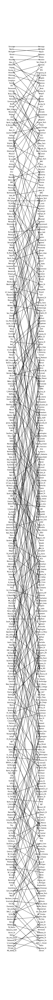

In [68]:
A = perm_to_series(massey_matrix.index,massey_perm,'Massey')
B = perm_to_series(colley_matrix.index,colley_perm,'Colley')
pyrankability.plot.spider2(A,B,file="results/2021_massey_colley.png",xmult = 1.7,ymult=1.1,height=100)

In [69]:
def compute_D(game_df,team_range,direct_thres=direct_thres,spread_thres=spread_thres):
    map_func = lambda linked: pyrankability.construct.support_map_vectorized_direct_indirect(linked,direct_thres=direct_thres,spread_thres=spread_thres)
    Ds = pyrankability.construct.V_count_vectorized(game_df,map_func)
    for i in range(len(Ds)):
        Ds[i] = Ds[i].reindex(index=team_range,columns=team_range)
    return Ds

In [70]:
import itertools

Ds = pd.DataFrame(columns=["Year","dt","st",'D',"ID"]) #{"direct": {},"direct_indirect_weighted": {}}
index_cols = list(Ds.drop(["D","ID"],axis=1).columns)
Ds.set_index(index_cols,inplace=True)
direct_thresholds = [0,1,2]
spread_thresholds = [0,1,2]

for year in games.keys():
    game_df = pd.DataFrame({"team1_name":games[year]['team1_name'],
                            "team1_score":games[year]['points1'],
                            "team1_H_A_N": games[year]['H_A_N1'],
                            "team2_name":games[year]['team2_name'],
                            "team2_score":games[year]['points2'],
                            "team2_H_A_N": games[year]['H_A_N1']})
    
    for direct_thres,spread_thres in itertools.product(direct_thresholds,spread_thresholds):
        #Ds.loc[(year,direct_thres,spread_thres),"Ds"] = 
        data=pd.Series(compute_D(game_df,team_range,direct_thres,spread_thres),index=["D","ID"],name=(year,direct_thres,spread_thres))
        Ds = Ds.append(data)

In [74]:
def plot_xstars(Ds,show_score_xstar2_func=lambda xstars: pyrankability.plot.show_score_xstar2(xstars,
                                                                     group_label="Group",width=300,height=300,
                                                                     columns=1,resolve_scale=True)):
    label = "A"
    xstars = {}
    for index in Ds.index:
        D = Ds.loc[index,'D']
        xstar = pd.DataFrame(Ds.loc[index,'details_cont'].x,index=D.index,columns=D.columns)
        xstars["%s. %s"%(label,", ".join(str(v) for v in index[::-1]))] = xstar
        label = chr(ord(label)+1)
    g,score_df,ordered_xstars = show_score_xstar2_func(xstars)
    return g,score_df,ordered_xstars

In [78]:
Ds

D  \
Year dt st                                                      
2021 0  0   team2           Massachusetts  SMU  Georgia_Te...   
        1   team2           Massachusetts  SMU  Georgia_Te...   
        2   team2           Massachusetts  SMU  Georgia_Te...   
     1  0   team2           Massachusetts  SMU  Georgia_Te...   
        1   team2           Massachusetts  SMU  Georgia_Te...   
        2   team2           Massachusetts  SMU  Georgia_Te...   
     2  0   team2           Massachusetts  SMU  Georgia_Te...   
        1   team2           Massachusetts  SMU  Georgia_Te...   
        2   team2           Massachusetts  SMU  Georgia_Te...   

                                                           ID  delta_cont  \
Year dt st                                                                  
2021 0  0   team2           Massachusetts  SMU  Georgia_Te...       189.0   
        1   team2           Massachusetts  SMU  Georgia_Te...         NaN   
        2   team2           Massachusetts  SMU  Georgia_Te...         NaN   
     1  0   team2           Massachusetts  SMU  Georgia_Te...         NaN   
        1   team2           Massachusetts  SMU  Georgia_Te...         NaN   
        2   team2           Massachusetts  SMU  Georgia_Te...         NaN   
     2  0   team2           Massachusetts  SMU  Georgia_Te...         NaN   
        1   team2           Massachusetts  SMU  Georgia_Te...         NaN   
        2   team2           Massachusetts  SMU  Georgia_Te...         NaN   

            details_cont  
Year dt st                
2021 0  0            NaN  
        1            NaN  
        2            NaN  
     1  0            NaN  
        1            NaN  
        2            NaN  
     2  0            NaN  
        1            NaN  
        2            NaN

In [79]:
class Details:
    def __init__(self, **entries):
        self.__dict__.update(entries)
        
Ds["delta_cont"] = np.NaN
Ds["details_cont"] = np.NaN
for index in Ds.index:
    D = Ds.loc[index,"D"]
    Ds.loc[index,"delta_cont"], details = pyrankability.rank.solve(D.fillna(0),method='lop',cont=True)
    details = Details(**details)
    Ds.loc[index,"details_cont"] = details

In [81]:
g,_,_ = plot_xstars(Ds)
g

alt.FacetChart(...)